In [18]:
import numpy as np
import matplotlib.pyplot as plt
from open_atmos_jupyter_utils import show_plot

In [19]:
def brownian_motion_trajectory(steps):
    x = np.cumsum(np.random.standard_normal(steps))
    y = np.cumsum(np.random.standard_normal(steps))
    return x, y

In [20]:
def monte_carlo(num_trajectories=1000, steps=1000, plot=False):
    empirical_var = np.zeros(num_trajectories)
    empirical_mean = np.zeros(num_trajectories)
    empirical_end = np.zeros((num_trajectories,2))
    if plot:
        fig, ax = plt.subplots()
        ax.set_title(f'trajectory {num_trajectories}')
    for i in range(num_trajectories):
        x, y = brownian_motion_trajectory(steps)
        empirical_mean[i] = np.sum(y[1:]-y[:-1])/steps
        empirical_var[i] = np.sum((x[1:]-x[:-1])**2)/steps
        empirical_end[i][:] = [x[-1], y[-1]]
        if plot:
            ax.plot(x, y)
            ax.grid()
    if plot:
        show_plot(f"trajectories_{num_trajectories}")
    return empirical_var, empirical_mean, empirical_end
                     

In [21]:
e_var, e_mean, e_end = monte_carlo(num_trajectories=1000, steps=1000, plot=True)

In [23]:
print(f"Empirical variance = {np.mean(e_var):.3f}\nEmpirical mean = {np.mean(e_mean):.3f}\nEmpirical end position = {np.mean(e_end,0)}")

Empirical variance = 1.001
Empirical mean = -0.002
Empirical end position = [-0.87359648 -1.91701837]


Text(0.5, 1.0, 'Final positions')

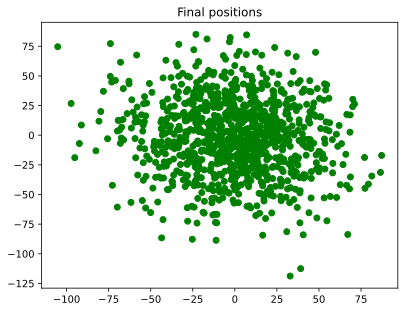

In [34]:
plt.plot(e_end[:,0],e_end[:,1], 'o', color='green')
plt.title("Final positions")

## Monte-Carlo

In [29]:
e_end.shape

(1000, 2)